In [1]:
#%matplotlib notebook
#%matplotlib inline


%load_ext autoreload
%autoreload 2

import cv2 
import matplotlib.pyplot as plt
import numpy as np
from cv2 import cv2
import ModelsConfiguration as config

models = config.GetModelsConfigured()

In [2]:
for model in models:
    print(model['Name'] + ' [OK-NG]: ' + str(len(model['OK']['Images'])) + '-' + str(len(model['NG']['Images'])))

CAUIM [OK-NG]: 3-3
DEMOISELLE [OK-NG]: 3-3
GOLDEN [OK-NG]: 3-3
INDICA [OK-NG]: 3-3
WITBIER [OK-NG]: 3-3


# Creating Image To Find With Harrys Detector and Create a Panoramic Image

In [ ]:
# Creating panoramic image from cilindric image of three shots

path_image_1 = 'images\Models\DEMOISELLE\OK\original\IMG_5420.jpg'
path_image_2 = 'images\Models\DEMOISELLE\OK\original\IMG_5421.jpg'
path_image_3 = 'images\Models\DEMOISELLE\OK\original\IMG_5422.jpg'

image_1 = cv2.imread(path_image_1)
image_2 = cv2.imread(path_image_2)
image_3 = cv2.imread(path_image_3)

plt.figure(figsize=[15, 7])
plt.imshow(cv2.cvtColor(image_1, cv2.COLOR_BGR2RGB))

plt.figure(figsize=[15, 7])
plt.imshow(cv2.cvtColor(image_2, cv2.COLOR_BGR2RGB))

plt.figure(figsize=[15, 7])
plt.imshow(cv2.cvtColor(image_3, cv2.COLOR_BGR2RGB))

# **** implement tutorial
# https://www.pyimagesearch.com/2018/12/17/image-stitching-with-opencv-and-python/


# **** verify if its necessary use image blending to concat the 3 images after to stitch the images ****

# Creating SIFT features

In [3]:
# **** FIND BEST PARAMS BY ANOTHER NOTEBOOK ****
sift_label = cv2.SIFT_create(nfeatures=0, nOctaveLayers=3, contrastThreshold=0.04, edgeThreshold=10, sigma=1.6)

In [4]:
# **** FIND BEST PARAMS BY ANOTHER NOTEBOOK ****
sift_label = cv2.SIFT_create(nfeatures=0, nOctaveLayers=3, contrastThreshold=0.04, edgeThreshold=10, sigma=1.6)

img_label = cv2.imread('.\\images\\Models\\' + models[0]['Name'] + '\\' +  models[0]['Label']['Images'][0])
keypoints, descriptors = sift_label.detectAndCompute(img_label, None)

#Add Features
models[0]['Label']['Features'].append({ 'Keypoints': keypoints, 'Descriptors': descriptors })

In [5]:

#Accessing objects

models[0]['Label']['Features'][0]['Keypoints'][0]
models[0]['Label']['Features'][0]['Descriptors'][0]

array([  2.,   5.,   1.,   1.,   1.,   0.,   0.,   1., 147.,   9.,   0.,
         0.,   1.,   1.,   1.,   5., 152.,  24.,   0.,   2.,  50.,   0.,
         0.,   1.,   3.,   1.,   0.,   3., 109.,   0.,   0.,   0.,   9.,
        16.,   3.,   0.,   0.,   0.,   0.,   2., 152.,  17.,   0.,   0.,
         0.,   0.,   0.,   5., 152.,  22.,   0.,   1.,  59.,   2.,   0.,
         4.,   7.,   1.,   0.,   1., 133.,   3.,   0.,   0.,  13.,   4.,
         1.,   1.,   0.,   0.,   0.,  11., 152.,  17.,   2.,   1.,   0.,
         0.,   0.,   8., 152.,   5.,   0.,   0.,  60.,   8.,   0.,  27.,
         7.,   0.,   0.,   0., 140.,   9.,   0.,   2.,   1.,   1.,   1.,
         2.,   6.,   2.,   1.,   3., 140.,  22.,   2.,   2.,   5.,   2.,
         0.,   4., 152.,   8.,   0.,   1.,  58.,   4.,   0.,  11.,   6.,
         0.,   0.,   1., 127.,   4.,   0.,   1.], dtype=float32)

# Systematic Analysis

In [6]:
# Systematic parameters
root_path = '.\\images\\Models\\'
show_labels = False
show_OK_images = False
show_NG_images = False
draw_keypoints_labels = True
draw_keypoints_images_OK = True
draw_keypoints_images_NG = True


# Best parameters found to create SIFT
p_nfeatures = 0
p_nOctaveLayers = 3
p_contrastThreshold = 0.04
p_edgeThreshold = 10
p_sigma = 1.6


# Matching parameters
p_TwoSidesCheck = False
p_QuantitiesOfTheBestMatchings = 2

In [11]:
for model in models:
    for label_image in model['Label']['Images']:
        img = cv2.imread(root_path + model['Name'] + '\\' +  label_image)
        model['Label']['ImagesReaded'].append(img)
        
        if show_labels:
            plt.figure(figsize=[15, 7])
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

        sift = cv2.SIFT_create(nfeatures = p_nfeatures, nOctaveLayers = p_nOctaveLayers, 
                               contrastThreshold = p_contrastThreshold, edgeThreshold = p_edgeThreshold, sigma = p_sigma)
        keypoints, descriptors = sift.detectAndCompute(img, None)
        
        model['Label']['SIFT'].append(sift)
        model['Label']['Features'].append( { 'Keypoints': keypoints, 
                                             'Descriptors': descriptors } )

        
    for OK_image in model['OK']['Images']:
        img = cv2.imread(root_path + model['Name'] + '\\OK\\' +  OK_image)
        model['OK']['ImagesReaded'].append(img)
        
        if show_OK_images:
            plt.figure(figsize=[15, 7])
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            
        sift = cv2.SIFT_create(nfeatures = p_nfeatures, nOctaveLayers = p_nOctaveLayers, 
                               contrastThreshold = p_contrastThreshold, edgeThreshold = p_edgeThreshold, sigma = p_sigma)
        keypoints, descriptors = sift.detectAndCompute(img, None)
        
        model['OK']['SIFT'].append(sift)
        model['OK']['Features'].append( { 'Keypoints': keypoints, 
                                          'Descriptors': descriptors } )
    
    for NG_image in model['NG']['Images']:
        img = cv2.imread(root_path + model['Name'] + '\\NG\\' +  NG_image)
        model['NG']['ImagesReaded'].append(img)
        
        if show_NG_images:
            plt.figure(figsize=[15, 7])
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        
        sift = cv2.SIFT_create(nfeatures = p_nfeatures, nOctaveLayers = p_nOctaveLayers, 
                               contrastThreshold = p_contrastThreshold, edgeThreshold = p_edgeThreshold, sigma = p_sigma)
        keypoints, descriptors = sift.detectAndCompute(img, None)
        
        model['NG']['SIFT'].append(sift)
        model['NG']['Features'].append( { 'Keypoints': keypoints, 
                                          'Descriptors': descriptors } )


# Draw keypoints on label

In [ ]:
if draw_keypoints_labels:
    
    for model in models:
        for idx, image in enumerate(model['Label']['ImagesReaded']):
            
            image_keypoints = np.zeros([image.shape[0], image.shape[1], 3], dtype=np.uint8)
            cv2.drawKeypoints(image, model['Label']['Features'][idx]['Keypoints'], image_keypoints, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
            plt.figure(figsize=[15, 7])
            plt.imshow(image_keypoints)

# Draw Keypoints on OK images

In [ ]:
if draw_keypoints_images_OK:
    
    for model in models:
        for idx, image in enumerate(model['OK']['ImagesReaded']):
            image_keypoints = np.zeros([image.shape[0], image.shape[1], 3], dtype=np.uint8)
            cv2.drawKeypoints(image, model['OK']['Features'][idx]['Keypoints'], image_keypoints, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
            plt.figure(figsize=[15, 7])
            plt.imshow(image_keypoints)

In [ ]:
if draw_keypoints_images_NG:
    
    for model in models:
        for idx, image in enumerate(model['NG']['ImagesReaded']):
            image_keypoints = np.zeros([image.shape[0], image.shape[1], 3], dtype=np.uint8)
            cv2.drawKeypoints(image, model['NG']['Features'][idx]['Keypoints'], image_keypoints, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
            plt.figure(figsize=[15, 7])
            plt.imshow(image_keypoints)

# Features Matching

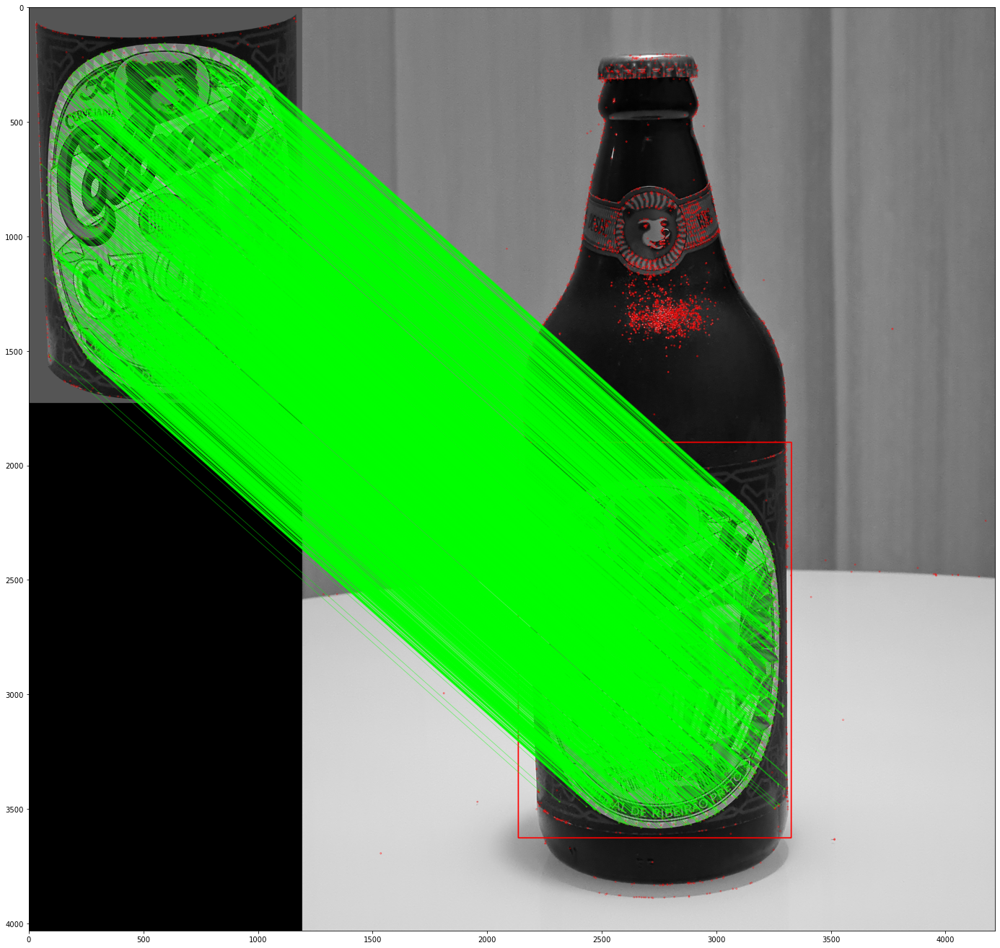

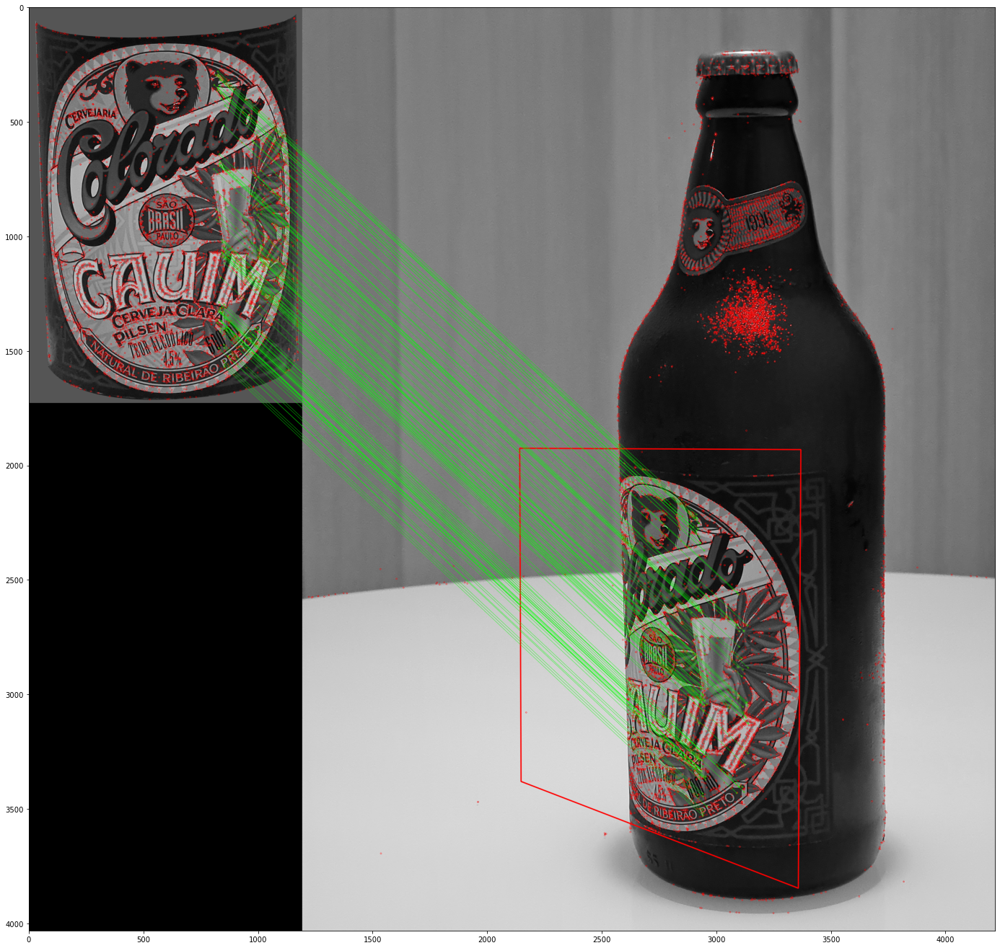

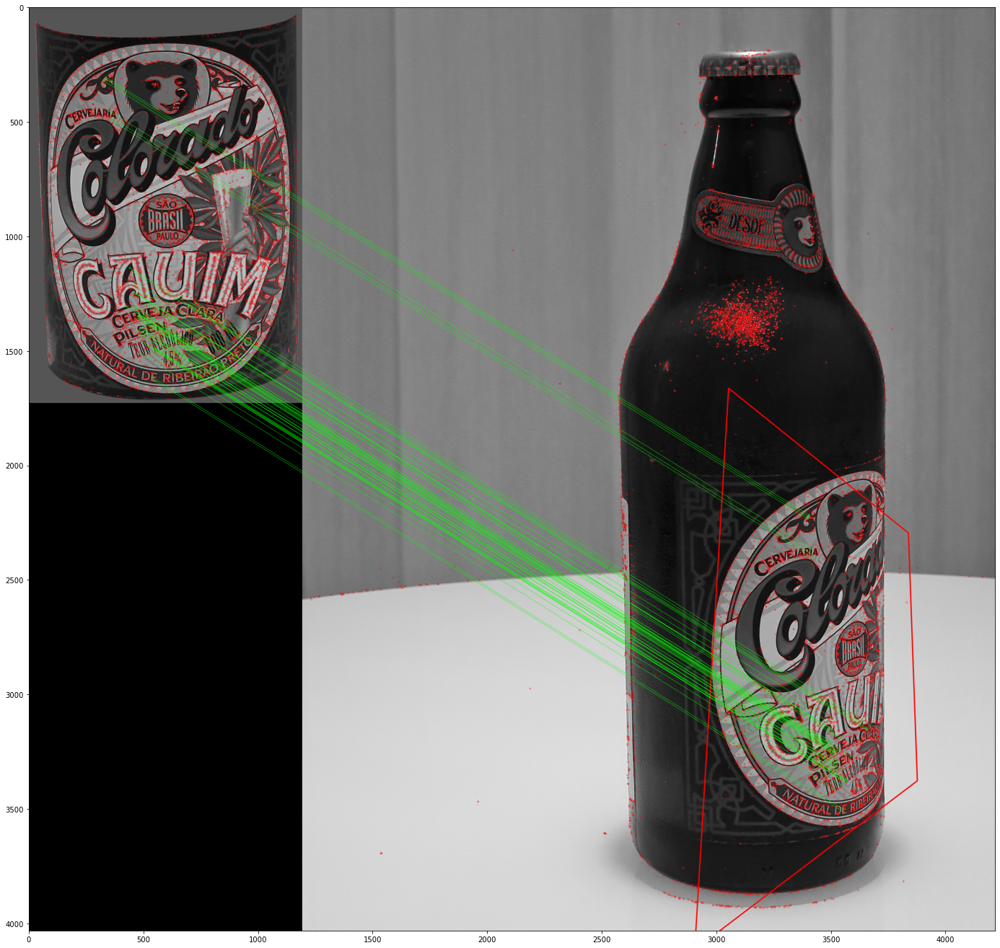

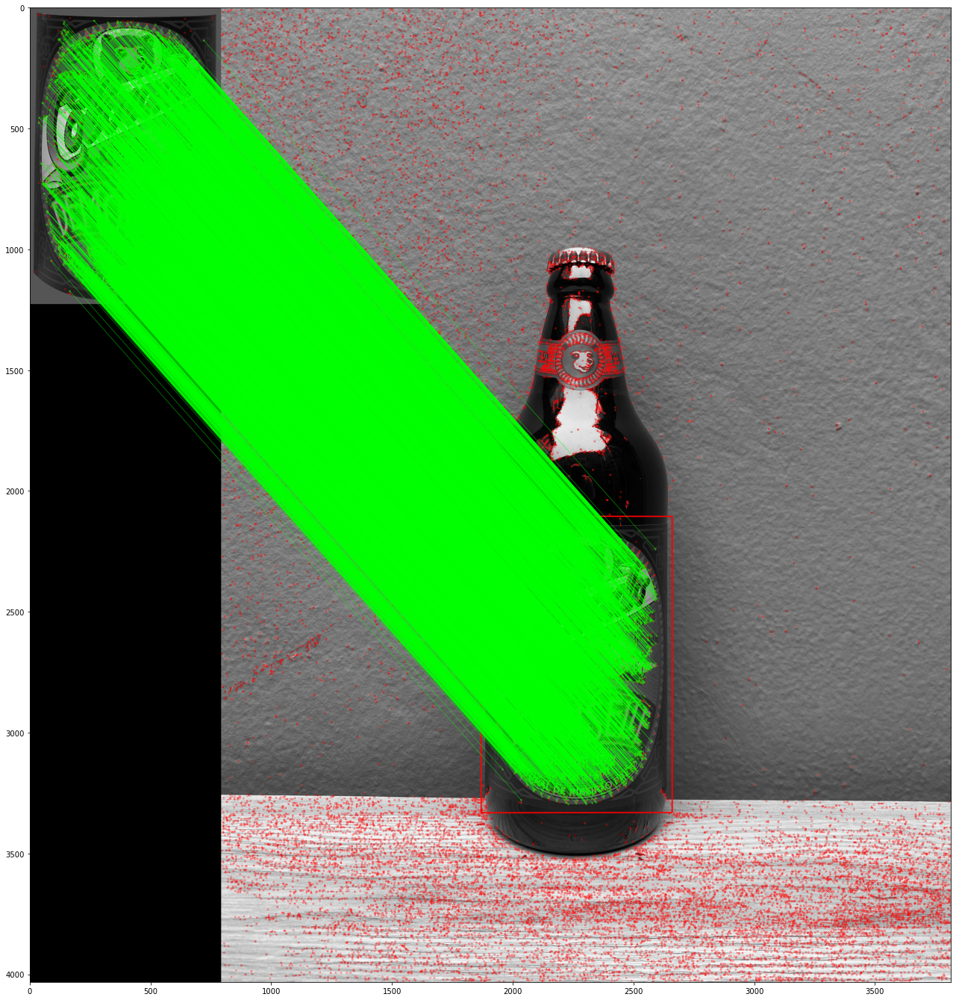

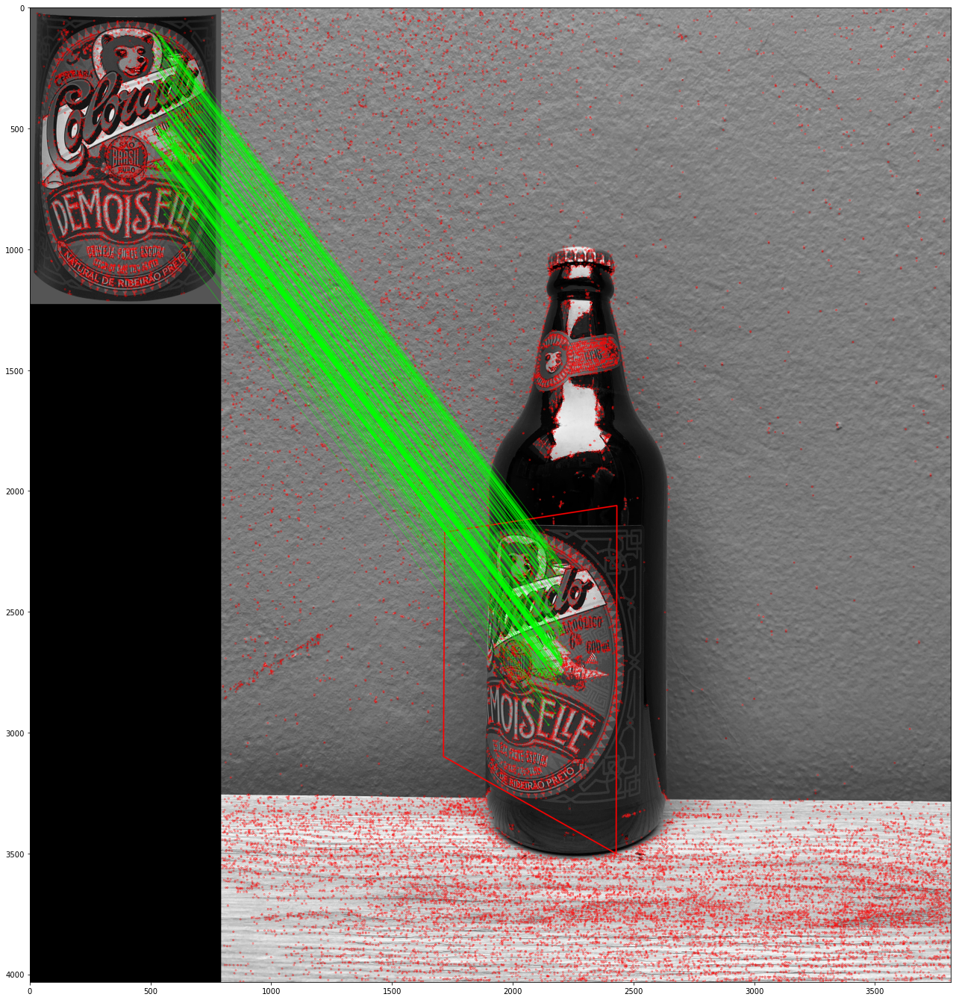

...

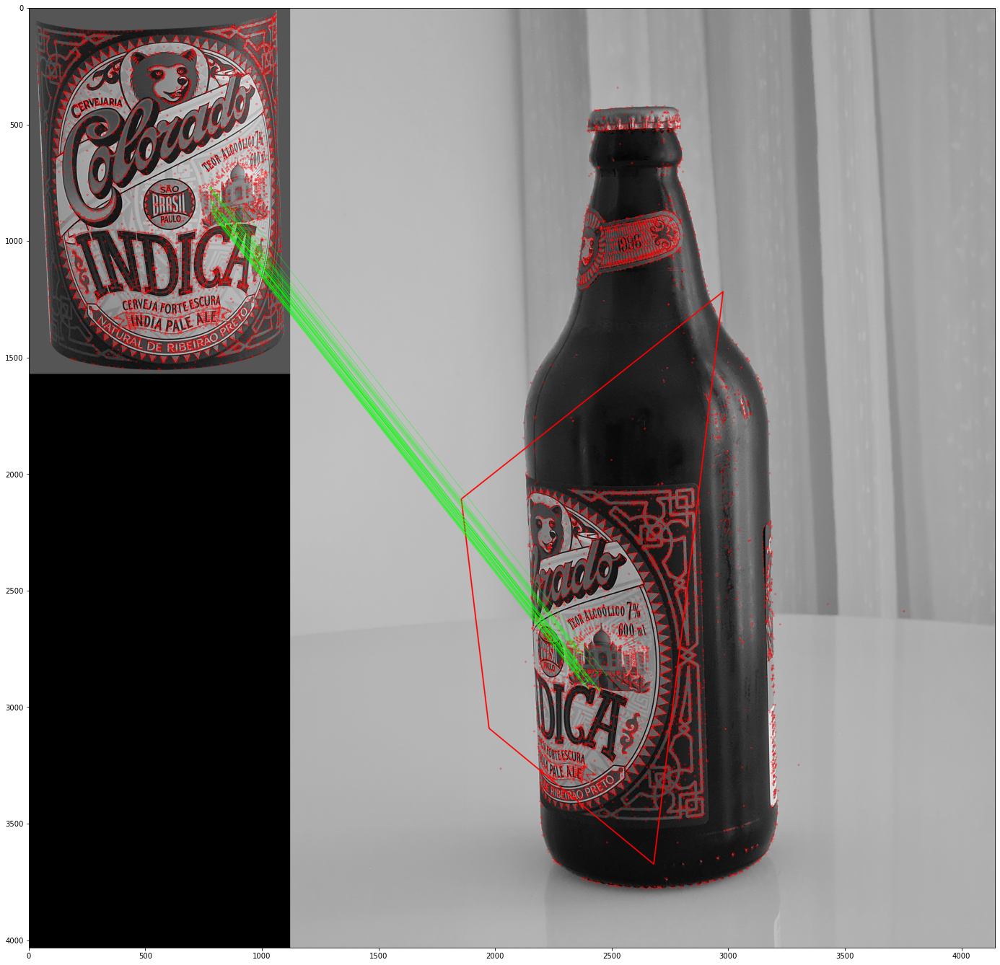

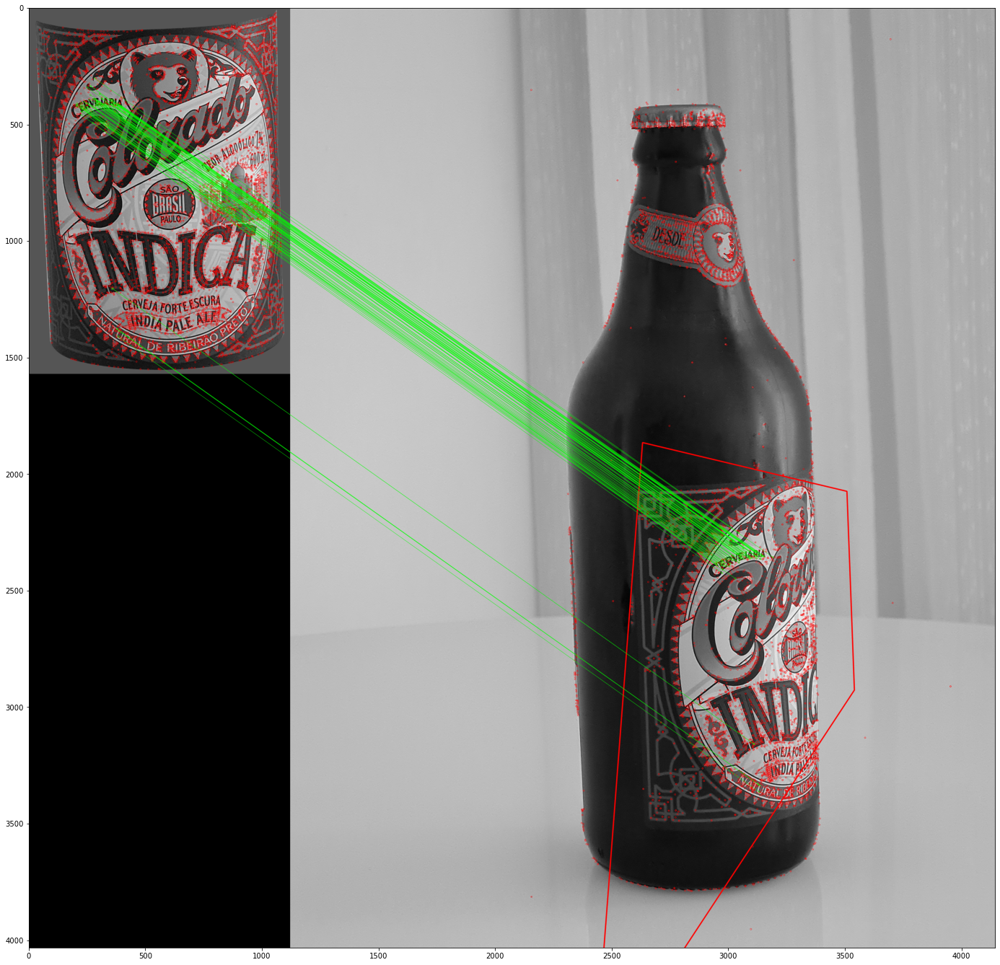

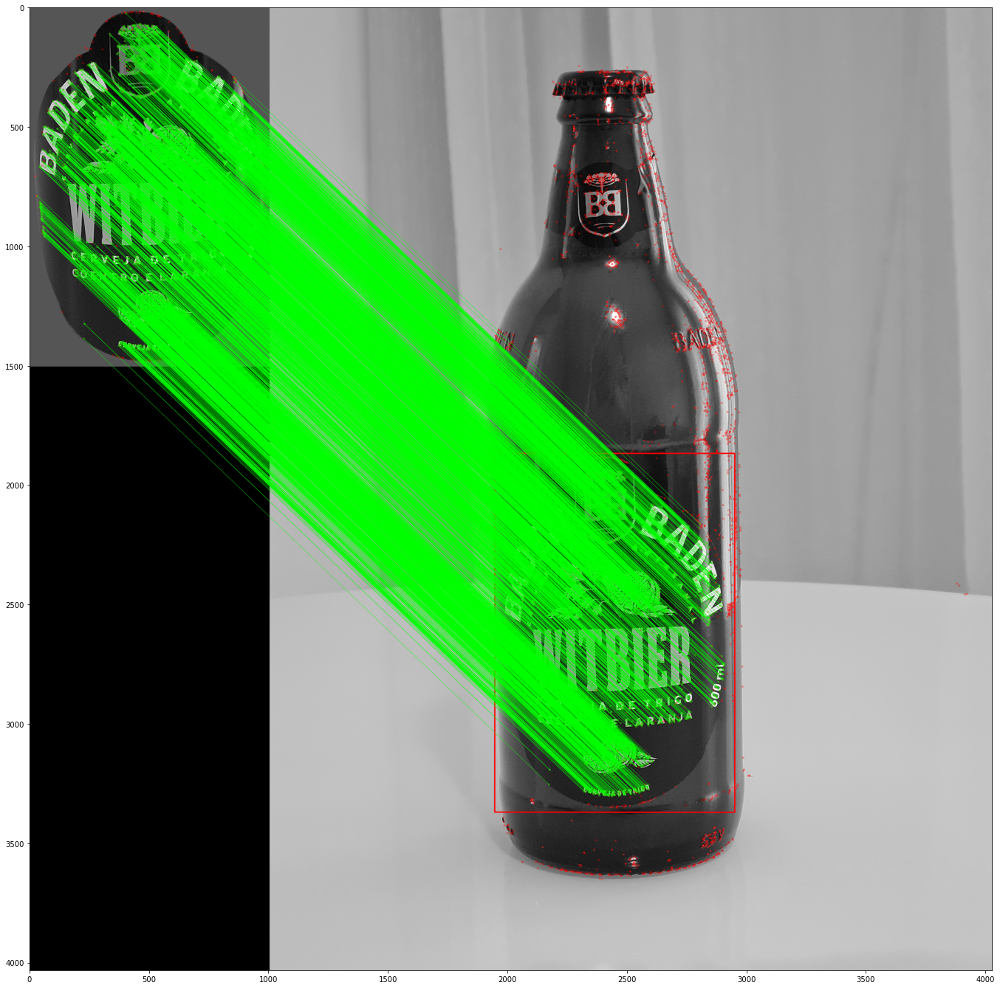

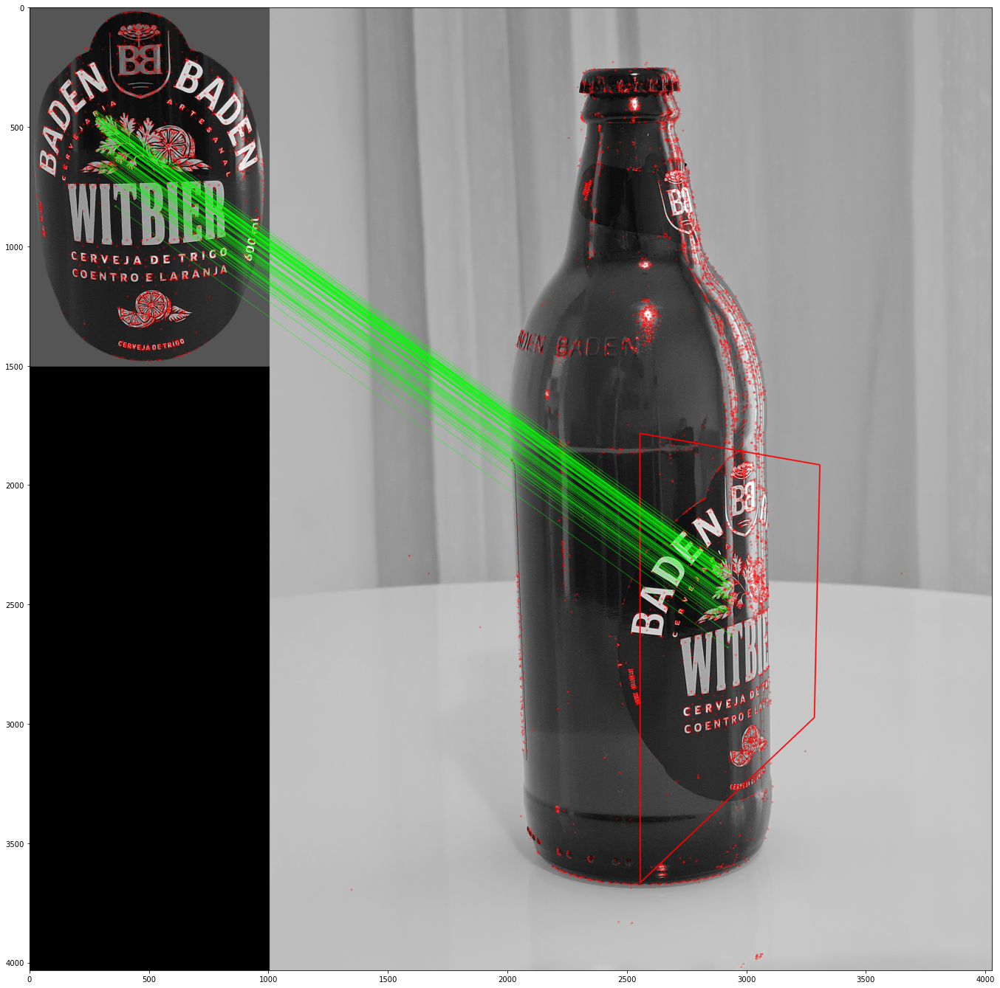

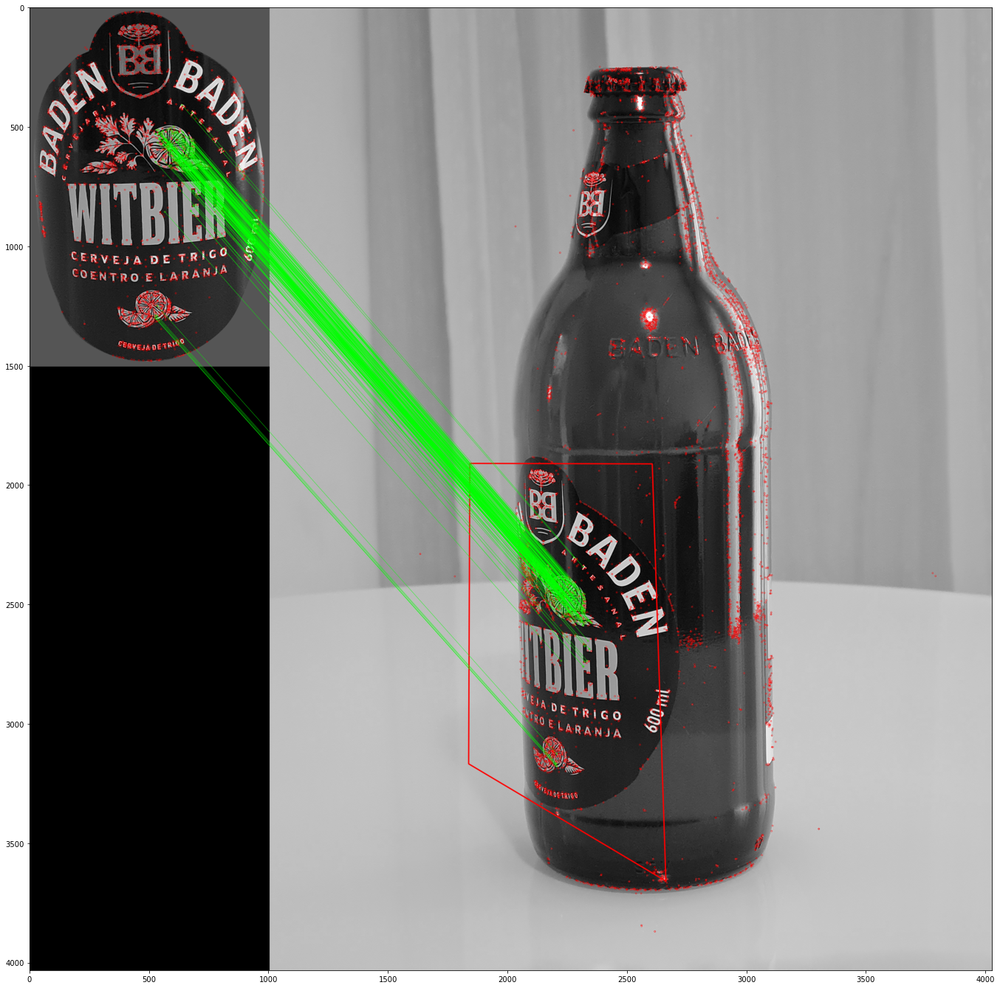

In [13]:
p_TwoSidesCheck = True
p_QuantitiesOfTheBestMatchings = 1

for model in models:
    #print(model['Name'])
    for idx, features in enumerate(model['OK']['Features']):
        matcher = cv2.BFMatcher(crossCheck = p_TwoSidesCheck)
        matches = matcher.knnMatch(model['Label']['Features'][0]['Descriptors'], features['Descriptors'], k = p_QuantitiesOfTheBestMatchings)
        
        
        img_result = cv2.drawMatchesKnn(model['Label']['ImagesReaded'][0], model['Label']['Features'][0]['Keypoints'], 
                                        model['OK']['ImagesReaded'][idx], features['Keypoints'], 
                                        matches, None, matchColor=(0, 255, 0), matchesMask=None,
                                        singlePointColor=(255, 0, 0), flags=0)

        #plt.figure(figsize=[24,24])
        #plt.imshow(img_result)
        
        
        
        
        ## Find homography
        matches_to_find = matches

        if type(matches_to_find[0]) is list:
            matches_to_find_plain = []
            for m in matches_to_find:
                if type(m) is list:
                    for n in m:
                        matches_to_find_plain.append(n)

            matches_to_find = matches_to_find_plain

        # Get positions of matching keypoints
        keypoints_label_pos = np.zeros([len(matches_to_find), 2], dtype=np.float32)
        keypoints_scene_pos = np.zeros([len(matches_to_find), 2], dtype=np.float32)

        for i, m in enumerate(matches_to_find):
            keypoints_label_pos[i] = model['Label']['Features'][0]['Keypoints'][m.queryIdx].pt
            keypoints_scene_pos[i] = features['Keypoints'][m.trainIdx].pt

        # T is the transformation matrix, mask is a boolean array indicating inlier points
        T, mask = cv2.findHomography(keypoints_label_pos, keypoints_scene_pos, 
                                     cv2.RANSAC, ransacReprojThreshold=3.0) 
        matchesMask = mask.ravel().tolist()
        
        
        label_img = cv2.cvtColor(model['Label']['ImagesReaded'][0], cv2.COLOR_BGR2GRAY)
            
        # Find transformation of rectangle delimiting object
        h, w = label_img.shape
        label_bounds = np.float32([[0,0], [0,h-1], [w-1,h-1], [w-1,0] ]).reshape(-1,1,2)
        label_bounds_in_scene = cv2.perspectiveTransform(label_bounds, T)

        # Draw polygon in the scene
        img_scene_box = cv2.polylines(model['OK']['ImagesReaded'][idx].copy(), [np.int32(label_bounds_in_scene)], True, 255, 3, cv2.LINE_AA)

        img_matches_RANSAC = cv2.drawMatches(model['Label']['ImagesReaded'][0], model['Label']['Features'][0]['Keypoints'], 
                                             img_scene_box, features['Keypoints'], 
                                             matches_to_find, None, matchColor=(0, 255, 0), matchesMask=matchesMask,
                                             singlePointColor=(255, 0, 0), flags=0)

        plt.figure(figsize=[24,24])
        plt.imshow(img_matches_RANSAC, 'gray')
        #print("---------------------------------")

# ORB (Oriented FAST and Rotated BRIEF)

In [ ]:
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt

img_orb = cv2.imread('.\\images\\Models\\' + models[3]['Name'] + '\\OK\\' +  models[3]['OK']['Images'][0])
img_orb_pb = cv2.cvtColor(img_orb, cv2.COLOR_BGR2GRAY)

orb = cv.ORB_create()

keypoints_orb = orb.detect(img_orb_pb, None)

keypoints_orb, des = orb.compute(img_orb_pb, keypoints_orb)

img_draw = cv.drawKeypoints(img_orb_pb, keypoints_orb, None, color=(0,255,0), flags=0)

plt.figure(figsize=(24,24))
plt.imshow(img_draw)
plt.show()